# Temperature

This notebook explores the analysis and sonification of temperature data in the UK from 2024 to 2098.
The ambient air temperature near the surface, typically at a height of 2m, is considered. The data represents the mean area average over three area aggregations: grid point, country level (NUTS level 0).

#### Workflow

1. **Data Loading and Preprocessing**
    - Import necessary libraries.
    - Load the temperature data from the CSV file.
    - Parse dates and filter the data for the years 2024 to 2098.
    - Convert temperature from Kelvin to Celsius.

2. **Data Analysis**
    - Calculate the mean temperature for each month and year.
    - Plot the mean temperature over the years.

3. **Sonification**
    - Normalize the temperature values.
    - Generate effects signals based on temperature.
    - Apply effects to the signals.
    - Combine the generated signals with a tree sound.

4. **Visualization**
    - Plot the final signal waveform.
    - Plot the monthly temperature for the year 2040.

5. **Sound Design**
    - Extract minimum and maximum temperatures.
    - Implement dynamic tempo, pitch shift, and reverb effects.
    - Play the final combined audio signal.


In [110]:
from libraries import *

In [155]:
# Adjust the relative path to the correct location
notebook_dir = os.getcwd()
temp_path = os.path.join(notebook_dir, '..', 'data_files', 'temperature.csv')

# Skip metadata rows and read the data
temp_df = pd.read_csv(
    temp_path, 
    skiprows=52,  # Skip rows up to the actual data header 
    sep=',',      # Specify the correct delimiter (comma in this case)
    engine='python',  # Use Python engine for flexible parsing
    on_bad_lines='skip'  # Skip any problematic rows
)

temp_df

,Date,AL,AT,BA,BE,BG,CH,CY,CZ,DE,...,NO,PL,PT,RO,RS,SE,SI,SK,TR,UK
0,1970-01-31,275.844828,265.209943,272.837592,271.712767,273.944403,264.708751,283.673541,266.553520,267.655611,...,265.887292,267.571375,280.541514,272.339905,273.688638,265.357922,269.534278,268.871963,273.227737,276.572673
1,1970-02-28,274.993295,269.706637,274.258576,274.621716,274.703420,267.574540,282.261323,271.099277,271.983659,...,267.114784,271.928975,282.247834,273.082250,274.811916,266.700651,272.876084,271.573611,271.661870,276.605918
2,1970-03-31,276.740977,273.541633,275.477086,280.460677,276.142663,272.587608,284.101738,275.364104,277.891974,...,271.573371,275.450061,286.134134,275.611623,276.402060,271.871123,276.630945,274.765148,276.228129,280.278043
3,1970-04-30,284.884881,279.823551,284.455268,285.125126,285.071800,277.849027,288.162090,283.254995,284.407149,...,275.096578,283.463870,285.435014,284.666201,285.934205,276.671030,284.162039,283.086236,282.232320,281.647203
4,1970-05-31,287.763929,283.570479,286.649250,287.254891,287.741816,282.029156,292.592642,286.874938,287.814017,...,279.749215,286.557383,288.489598,287.234617,288.662066,281.940927,287.541788,286.314767,286.295354,283.486842
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1543,2098-08-31,302.293870,294.509723,299.820715,294.523699,301.065517,294.173843,307.472484,294.511068,294.688563,...,289.725799,293.307918,300.783392,298.812129,300.411482,290.804283,298.663232,295.192379,302.992737,292.090237
1544,2098-09-30,296.664774,289.515088,293.546205,291.996567,295.816236,288.754067,304.947392,289.840293,290.800059,...,285.926437,289.828494,299.985354,292.551930,294.288252,286.946669,293.196375,290.215089,298.758743,290.784606
1545,2098-10-31,292.959629,286.290727,289.880660,289.509916,289.905691,285.466037,300.707999,287.556829,288.598764,...,282.509708,287.019876,297.528128,287.878582,290.097115,283.196183,289.166891,286.693151,292.528705,288.767088
1546,2098-11-30,285.104485,277.006020,281.709599,279.486172,282.166540,276.421482,295.873774,278.375501,278.742816,...,273.553538,278.152446,291.285559,279.554202,281.478546,274.154587,280.069983,278.521267,286.808380,281.167716


## Cleaning Process

In [112]:
# Ensure 'Date' is parsed as a datetime column
temp_df['Date'] = pd.to_datetime(temp_df['Date'])

# Extract the year and month from 'Date'
temp_df['Year'] = temp_df['Date'].dt.to_period('M')

# Filter rows between 2024 and 2098
temp_pred = temp_df[temp_df['Year'] >= '2024-01']

# Select only 'YearMonth' and 'UK' columns
temp_uk = temp_pred[['Year', 'UK']].copy()

# Convert temperature from Kelvin to Celsius without decimal points
temp_uk['Temperature(°C)'] = (temp_uk['UK'] - 273.15).astype('int64')

# Drop the original 'UK' column
temp_uk = temp_uk.drop(columns=['UK'])

print(temp_uk)

         Year  Temperature(°C)
648   2024-01                5
649   2024-02                6
650   2024-03                7
651   2024-04                8
652   2024-05               10
...       ...              ...
1543  2098-08               18
1544  2098-09               17
1545  2098-10               15
1546  2098-11                8
1547  2098-12                8

[900 rows x 2 columns]


    Year  Temperature(°C)
0   2024         9.833333
1   2025        10.500000
2   2026         9.250000
3   2027         9.250000
4   2028         9.500000
..   ...              ...
70  2094        12.583333
71  2095        12.083333
72  2096        12.833333
73  2097        12.916667
74  2098        11.833333

[75 rows x 2 columns]


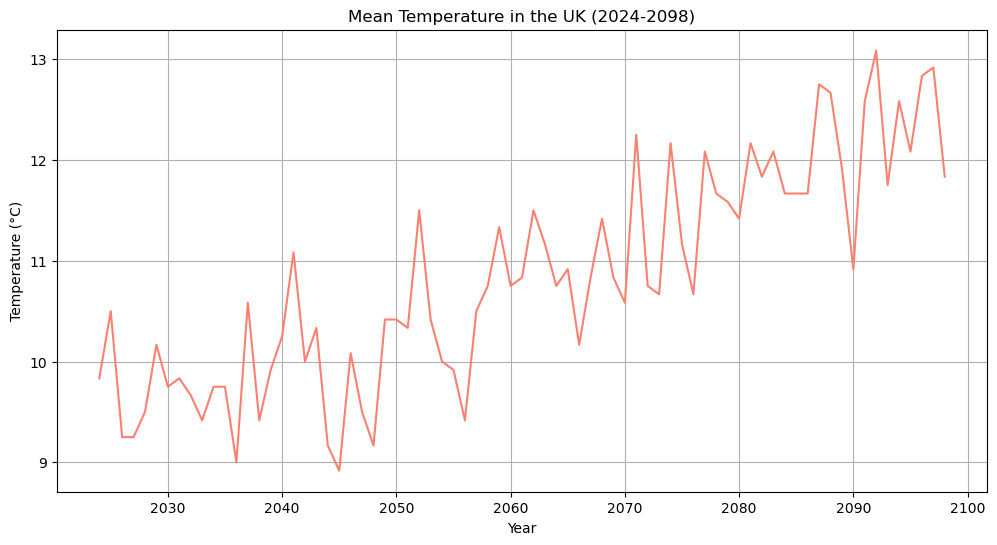

In [113]:
# Calculate the mean temperature for each month
temp_uk_mean = temp_uk.groupby(temp_uk['Year'].dt.to_timestamp().dt.year)['Temperature(°C)'].mean().reset_index()

print(temp_uk_mean)

# Plot the mean temperature for each year
plt.figure(figsize=(12, 6))
sns.lineplot(data=temp_uk_mean, x='Year', y='Temperature(°C)', color='salmon')
plt.title('Mean Temperature in the UK (2024-2098)')
plt.xlabel('Year')
plt.ylabel('Temperature (°C)')
plt.grid(True)
plt.show()

For the prototype, we will focus on the year 2040.

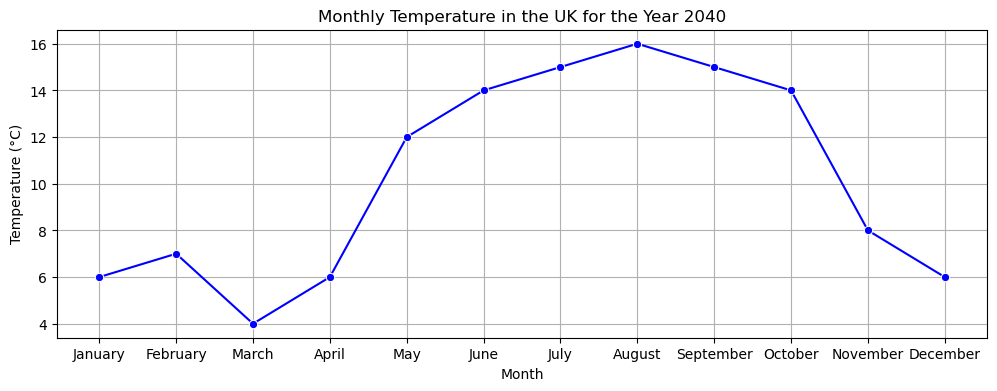

          Year  Temperature(°C)      Month
840 2040-01-01                6    January
841 2040-02-01                7   February
842 2040-03-01                4      March
843 2040-04-01                6      April
844 2040-05-01               12        May
845 2040-06-01               14       June
846 2040-07-01               15       July
847 2040-08-01               16     August
848 2040-09-01               15  September
849 2040-10-01               14    October
850 2040-11-01                8   November
851 2040-12-01                6   December


In [169]:
temp_uk_2040 = temp_uk[temp_uk['Year'].dt.year == 2040].copy()

# Convert 'Year' to datetime for plotting
temp_uk_2040['Year'] = temp_uk_2040['Year'].dt.to_timestamp()

# Extract month for plotting
temp_uk_2040['Month'] = temp_uk_2040['Year'].dt.strftime('%B')

plt.figure(figsize=(12, 4))
sns.lineplot(data=temp_uk_2040, x='Month', y='Temperature(°C)', marker='o', color='blue')
plt.title('Monthly Temperature in the UK for the Year 2040')
plt.xlabel('Month')
plt.ylabel('Temperature (°C)')
plt.grid(True)
plt.show()

print(temp_uk_2040)

# Sound Design 

Extract the meanfull values to be mapped.
This attempt creates a hum sound using reverb combined with a pitch shift to evoke a feeling of alertness.


In [171]:
# Extract minimum and maximum temperatures from temp_uk
min_temperature = temp_uk_2040['Temperature(°C)'].min()
max_temperature = temp_uk_2040['Temperature(°C)'].max()

# Set the duration (1 second for each temperature measurement in the array)
duration = len(temp_uk_2040)  # 1 second for each month

print(f"Min Temperature: {min_temperature}°C")
print(f"Max Temperature: {max_temperature}°C")
print(f"Duration: {duration} seconds")

Min Temperature: 4°C
Max Temperature: 16°C
Duration: 12 seconds



The next few cells implement a few effect functions to be used in the mapping.

The mapping strategy is based on the concept of one-to-many from The Sonification Handbook, mapping one data feature to several synthesis parameters.



In [122]:
# Dynamic tempo effect
# librosa.effects.time_stretch(y, *, rate, **kwargs)
# Stretch factor. If rate > 1, then the signal is sped up. If rate < 1, then the signal is slowed down.
# need set implicit rate parameter , because the definition of function has additional parameter, then parameter rate
def time_stretch(signal, rate=1.0):

    
    if rate <= 0:
        raise ParameterError("rate must be a positive number")

    return lr.effects.time_stretch(signal, rate=rate)

In [117]:
# Scratch sound effect
# librosa.effects.pitch_shift(y, *, sr, n_steps, bins_per_octave=12, res_type='soxr_hq', scale=False, **kwargs)
# Resample type. By default, ‘soxr_hq’ is used. (high quality)
# A step is equal to a semitone if bins_per_octave is set to 12.

def pitch_shift_signal(signal, sampling_rate, n_steps, bins_per_octave=12, res_type='soxr_hq', scale=False):

    return lr.effects.pitch_shift(signal, sr=sampling_rate, n_steps=n_steps, 
                                  bins_per_octave=bins_per_octave, res_type=res_type, scale=scale)

In [138]:
# Impulse response generation
# An impulse response is used as a stand-in for a natural reverb
def impulse_response(fs, decay=0.5, length=0.3):
    
    ir_length = int(fs * length)  # Length of the impulse response
    impulse = np.exp(-np.linspace(0, decay, ir_length))  # Exponential decay

    return impulse

# Convolution reverb effect
# Not using convolve as it is not efficient for long signals
def apply_reverb(signal, fs, decay=0.5, delay=0.02):
    
    delay_samples = int(fs * delay)  # Delay in samples
    reverb_signal = np.zeros_like(signal)  # Initialize the reverb signal
    
    for i in range(delay_samples, len(signal)):
        reverb_signal[i] = signal[i] + decay * reverb_signal[i - delay_samples]

    return reverb_signal

# Implementation

The final signal is normalized.


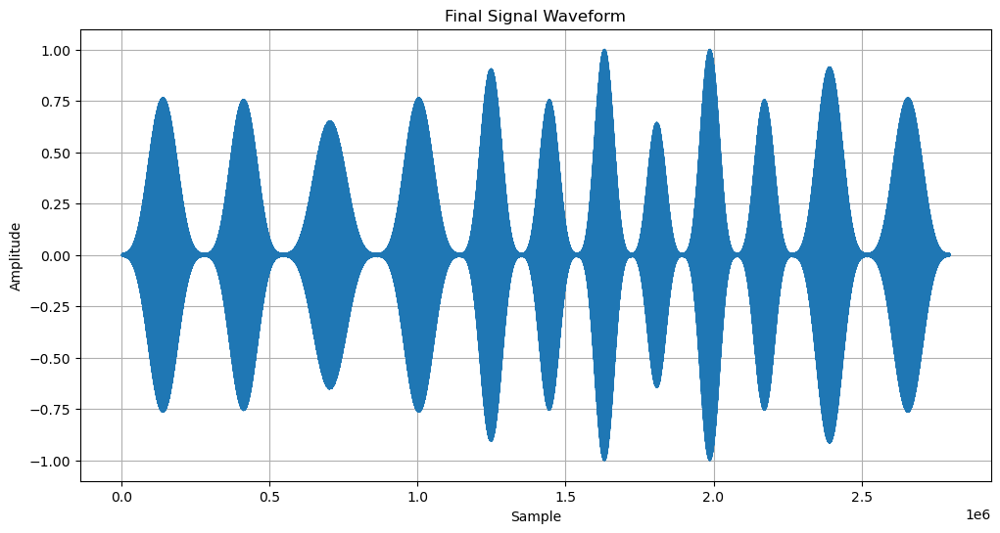

Playing the final signal


In [165]:
# Normalize the temperature values
temperature_values = temp_uk_2040['Temperature(°C)'].values
temperature_values = (temperature_values - min_temperature) / (max_temperature - min_temperature)

# Sampling frequency
fs = 44100  

# Duration of each tone in seconds
duration_per_sample = 5 

# Frequency range for dynamic base frequency
base_frequency = 220  # in Hz

# Generate pitch-shifted and time-stretched signals based on temperature
ps_signals = []

for temp in temperature_values:
    # Basic sine wave
    t = np.linspace(0, duration_per_sample, int(fs * duration_per_sample), endpoint=False)
    sine_wave = 0.5 * np.sin(2 * np.pi * base_frequency * t)

    # Apply Hamming window to the sine wave
    # Hamming : Wider main lobe, peak amplitude of side lobe is < -41dB
    hamming_window = np.hamming(len(sine_wave))
    sine_wave *= hamming_window

    # Normalize the sine wave
    sine_wave /= np.max(np.abs(sine_wave))

    # Pitch shift the sine wave
    # (temp - 0.5) = Centers the normalized value around 0
    # 12 ensures the pitch shift spans ±6 semitones
    n_steps = (temp - 0.5) * 12 
    signal = pitch_shift_signal(sine_wave, sampling_rate=fs, n_steps=n_steps)

    # Apply windowing 
    signal *= hamming_window  

    # Time-stretch the signal
    rate = 1 + (temp - 0.5)  # Map normalized temperature to time stretch rate
    signal = time_stretch(signal, rate=rate)

    ps_signals.append(signal)

# Concatenate all pitch-shifted and time-stretched signals
signal = np.concatenate(ps_signals)

# Add reverb to the flat signal
final_signal = apply_reverb(signal, fs, decay=0.7, delay=0.07)

# Normalize the final signal
final_signal /= np.max(np.abs(final_signal))

# Check if the final signal is normalized
if np.max(np.abs(final_signal)) <= 1.0:
    print("The final signal is normalized.")
else:
    print("The final signal is not normalized.")

# Plot the final signal to visually inspect it
plt.figure(figsize=(12, 6))
plt.plot(final_signal)
plt.title('Final Signal Waveform')
plt.xlabel('Sample')
plt.ylabel('Amplitude')
plt.grid(True)
plt.show()

# Play the audio signal
print("Playing the final signal")
play(final_signal, fs)


#### Inspecting pre recornding sound (oak tree sound)

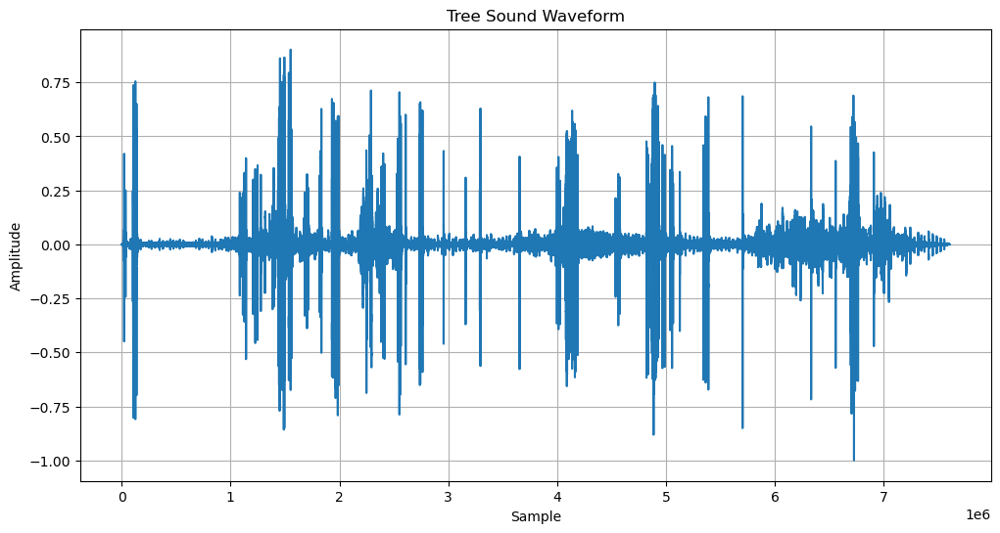

In [162]:
# Load the tree sound
notebook_dir = os.getcwd()
temp_path = os.path.join(notebook_dir, '..', 'media', 'odry_trees.wav')
tree_sound = wavReadMono(temp_path)

# Normalize the tree sound
tree_sound /= np.max(np.abs(tree_sound))


# plot the tree sound
plt.figure(figsize=(12, 6))
plt.plot(tree_sound)
plt.title('Tree Sound Waveform')
plt.xlabel('Sample')
plt.ylabel('Amplitude')
plt.grid(True)
plt.show()

# Play the tree sound
play(tree_sound, fs)

#### Combining sounds

The combined signal is normalized.


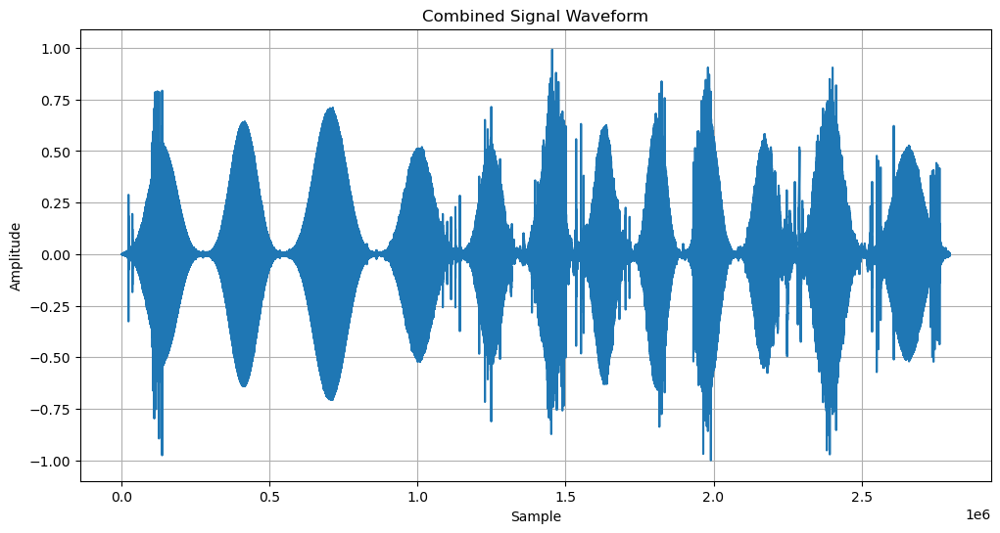

In [164]:
# Cut the tree sound to match the final signal duration
tree_sound = tree_sound[:len(final_signal)]

# Add the final signal to the tree sound
combined_signal = tree_sound + final_signal

# Normalize the combined signal
combined_signal /= np.max(np.abs(combined_signal))#

# Check if the combined signal is normalized
if np.max(np.abs(combined_signal)) <= 1.0:
    print("The combined signal is normalized.")
else:
    print("The combined signal is not normalized.")

# Plot the combined signal to visually inspect it
plt.figure(figsize=(12, 6))
plt.plot(combined_signal)
plt.title('Combined Signal Waveform')
plt.xlabel('Sample')
plt.ylabel('Amplitude')
plt.grid(True)
plt.show()


# Play the combined audio signal
play(combined_signal, fs)